# SBI experiments: an introduction

In this notebook, we will analyse the performance of Simulation-based inference algorithms in estimating the posterior distribution of the parameters defined in the Two Moons model.

## The model

We will choose a model where both parameters and data are sampled from a multivariate normal distribution.

The parameters $\boldsymbol{\theta} \in \mathbb{R}^n$ are sampled from

$$ \boldsymbol{\theta} \sim \mathcal{N}(\mu=\boldsymbol{0}_n, \Sigma_1=0.01 \boldsymbol{I}_n),$$

where $\boldsymbol{I}_n$ is the n x n identity matrix and $\boldsymbol{0}_n = \begin{pmatrix} 0 & \ldots & 0 \end{pmatrix}^T \in \mathbb{R}^n$. The data $\boldsymbol{x} \in \mathbb{R}^n$ are generated as follows:

$$ \boldsymbol{x} \sim \mathcal{N}(\mu=\boldsymbol{\theta}, \Sigma_2=0.01 \boldsymbol{I}_n) $$

### The analytical posterior

\begin{align*}
\log p(\boldsymbol{\theta} | \boldsymbol{x}) &\propto -\frac{1}{2}(\boldsymbol{x} - \boldsymbol{\theta})^T \Sigma^{-1}_2 (\boldsymbol{x} -\boldsymbol{\theta}) - \frac{1}{2}\boldsymbol{\theta}^T \Sigma^{-1}_1 \boldsymbol{\theta}\\
&\propto \boldsymbol{\theta}^T \Sigma^{-1}_2 \boldsymbol{x} - \frac{1}{2}\boldsymbol{\theta}^T(\Sigma^{-1}_1 + \Sigma^{-1}_2)\boldsymbol
{\theta},
\end{align*}

which, after completing the square, is found to follow a multivariate normal $\mathcal{N}(\mu, \Sigma_T)$ distribution of mean and convariance matrix

$$ \Sigma_T = (\Sigma_1^{-1} + \Sigma_2^{-1})^{-1} = 0.005 \boldsymbol{I}_n$$

$$ \mu = \Sigma_T \Sigma^{-1}_2 \boldsymbol{x} = \frac{\boldsymbol{x}}{2}$$


In [1]:
import sys

sys.path.append("..")

import torch
from torch import Tensor
import arviz as az
from sbi import analysis as analysis
from sbi import utils as utils
from sbi.inference import simulate_for_sbi
from sbi.utils.user_input_checks import (
    check_sbi_inputs,
    process_prior,
    process_simulator,
)

%config InlineBackend.figure_format = 'retina'

/Users/bernardoveronese/miniconda3/envs/sbibench/lib/python3.10/site-packages/threadpoolctl.py:1214: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)


We implement the model in the two functions below. Pytorch is a a machine learning library. In a nutshell, multi-dimensional arrays in Pytorch are a `torch.Tensor`, and have very similar functionalities to Numpy's `ndarray` class, while also having support for running on GPUs.

We are using Pyro because we are going to benefit from its built-in implementation of some MCMC samplers.

In [33]:
ndim = 10
seed = 1998
torch.manual_seed(seed)
# pyro.set_rng_seed(seed)

# def prior_dist():
#     loc = pyro.param("loc", lambda: torch.zeros(ndim))
#     covariance_matrix = pyro.param("covariance_matrix", lambda: 0.1 * torch.eye(ndim))
#     return dist.MultivariateNormal(loc=loc, covariance_matrix=covariance_matrix)

# # def simulator(theta: Tensor):
# #     covariance_matrix = pyro.param("covariance_matrix", lambda: 0.1 * torch.eye(ndim))
# #     return pyro.sample('x', dist.MultivariateNormal(theta, covariance_matrix=covariance_matrix))

# def model():
#     """The model generates samples from p(\theta, x)"""
#     loc = pyro.param("loc", lambda: torch.zeros(ndim))
#     covariance_matrix = pyro.param("covariance_matrix", lambda: 0.1 * torch.eye(ndim))
#     theta = pyro.sample('theta', dist.MultivariateNormal(loc=loc, covariance_matrix=covariance_matrix))
#     return pyro.sample('x', dist.MultivariateNormal(theta, covariance_matrix=covariance_matrix))

# def gaussian_linear_simulator(params: Tensor):
#     """Here we are telling pyro to generate samples from p(x | \theta = params)"""
#     conditioned_model = pyro.poutine.condition(model, data={'theta': params})
#     return conditioned_model()
cov = 0.01
theta_loc = torch.zeros(ndim)
theta_precision_matrix = cov * torch.eye(ndim)
x_precision_matrix = cov * torch.eye(ndim)


def get_prior() -> torch.distributions.Distribution:
    return torch.distributions.MultivariateNormal(
        loc=theta_loc, precision_matrix=theta_precision_matrix
    )


def gaussian_linear_simulator(theta: Tensor) -> Tensor:
    batch_shape = theta.shape[0]
    x_dist = torch.distributions.MultivariateNormal(
        loc=theta, precision_matrix=x_precision_matrix
    )
    return x_dist.expand((batch_shape,)).sample()


def get_true_posterior_samples(num_samples: torch.Size, x: Tensor) -> Tensor:
    covariance_matrix = torch.inverse(theta_precision_matrix + x_precision_matrix)
    loc = torch.matmul(torch.matmul(covariance_matrix, x_precision_matrix), x.squeeze())
    return torch.distributions.MultivariateNormal(
        loc=loc, covariance_matrix=covariance_matrix
    ).sample(num_samples)


# def gaussian_linear_model(params: Tensor = None, data: Tensor = None):
#     assert not (params is None and data is None), 'One of `params` or `data` must be specified'
#     n = params.shape[0] if params is not None else data.shape[0]
#     loc = pyro.param("loc", lambda: torch.zeros(ndim))
#     scale = pyro.param("scale", lambda: 0.1 * torch.eye(ndim))
#     with pyro.plate("data", n):
#         theta = pyro.sample("theta", dist.MultivariateNormal(loc, scale), obs=params)
#         obs = pyro.sample("obs", dist.MultivariateNormal(theta, scale), obs=data)
#         return obs

In [3]:
# num_simulations = 1000
# prior_predictive = pyro.infer.Predictive(model, num_samples=num_simulations)
# samples = prior_predictive()
# print(samples.keys())

In [4]:
def get_labels_for_var(var: str, n: int):
    return list(map(lambda i: f"${var}_{{{i}}}$", range(1, n + 1)))


def tensor_to_dataset(labels, tensor):
    return dict(zip(labels, [tensor[..., i] for i in range(tensor.shape[-1])]))


# theta_labels = get_labels_for_var('\\theta', theta.shape[-1])
# prior_data = dict(zip(theta_labels, [theta[..., i] for i in range(theta.shape[-1])]))
# plot_kwargs = dict(var_names=theta_labels, shade=0.8, grid=(5,2), figsize=(12, 20), show=True)
# axs = az.plot_density(prior_data, $$plot_kwargs)
# fig = axs[0][0].get_figure()
# fig.tight_layout()

In the cell below, we use the `process_prior` and `process_simulator` helper methods from `sbi` to convert the prior and simulator into the expected signature. Alternatively, you may use the helper method `sbisandbox.utils.validate_model`.

In [5]:
prior = get_prior()
# Check prior, return PyTorch prior.
prior, num_parameters, prior_returns_numpy = process_prior(prior)

# Check simulator, returns PyTorch simulator able to simulate batches.
simulator = process_simulator(gaussian_linear_simulator, prior, prior_returns_numpy)

# Consistency check after making ready for sbi.
check_sbi_inputs(simulator, prior)

Let us use the `simulate_for_sbi` helper method to generate samples of $\theta$ and $x$.

In [6]:
theta, x = simulate_for_sbi(simulator, proposal=prior, num_simulations=1000)

Running 1000 simulations.:   0%|          | 0/1000 [00:00<?, ?it/s]

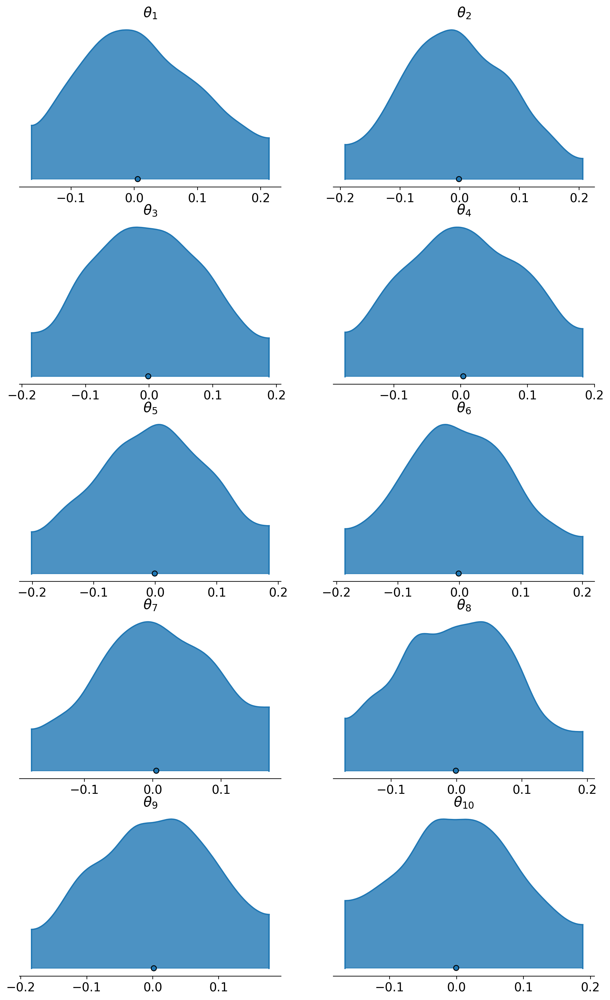

array([[<Axes: title={'center': '$\\theta_{1}$'}>,
        <Axes: title={'center': '$\\theta_{2}$'}>],
       [<Axes: title={'center': '$\\theta_{3}$'}>,
        <Axes: title={'center': '$\\theta_{4}$'}>],
       [<Axes: title={'center': '$\\theta_{5}$'}>,
        <Axes: title={'center': '$\\theta_{6}$'}>],
       [<Axes: title={'center': '$\\theta_{7}$'}>,
        <Axes: title={'center': '$\\theta_{8}$'}>],
       [<Axes: title={'center': '$\\theta_{9}$'}>,
        <Axes: title={'center': '$\\theta_{10}$'}>]], dtype=object)

In [7]:
theta_labels = get_labels_for_var("\\theta", ndim)
theta_dataset = tensor_to_dataset(theta_labels, theta)

plot_kwargs = dict(shade=0.8, grid=(5, 2), figsize=(12, 20), show=True)
az.plot_density(theta_dataset, var_names=theta_labels, **plot_kwargs)

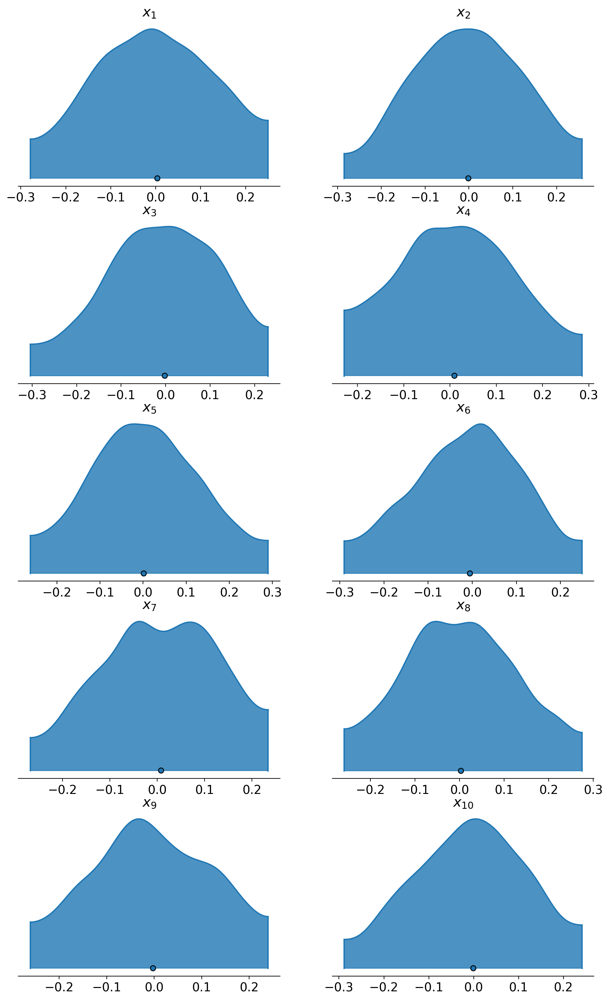

array([[<Axes: title={'center': '$x_{1}$'}>,
        <Axes: title={'center': '$x_{2}$'}>],
       [<Axes: title={'center': '$x_{3}$'}>,
        <Axes: title={'center': '$x_{4}$'}>],
       [<Axes: title={'center': '$x_{5}$'}>,
        <Axes: title={'center': '$x_{6}$'}>],
       [<Axes: title={'center': '$x_{7}$'}>,
        <Axes: title={'center': '$x_{8}$'}>],
       [<Axes: title={'center': '$x_{9}$'}>,
        <Axes: title={'center': '$x_{10}$'}>]], dtype=object)

In [8]:
x_labels = get_labels_for_var("x", ndim)
x_dataset = tensor_to_dataset(x_labels, x)

az.plot_density(x_dataset, var_names=x_labels, **plot_kwargs)

The output of prior + simulator is the set 

$$\{(\boldsymbol{\theta}_i, \boldsymbol{x}_i)\},$$

for $i=1, \ldots, N_{sim}$. This will be the data used for the training and validation of the neural network.

## Neural Posterior Estimation (NPE)

Neural Posterior Estimation (NPE) consists of training a neural density estimator with a simulated dataset to directly approximate the posterior~\citep{papamakarios_fast_2016, lueckmann_flexible_2017}. One advantage of this approach is that one can directly sample from the amortized approximation of the posterior, without having to perform extra MCMC steps.

The estimator is trained to minimize the loss function

$$
    \mathcal{L} = \mathbb{E}_{\boldsymbol{\theta} \sim \boldsymbol{\theta}} \mathbb{E}_{\boldsymbol{x} \sim p(\boldsymbol{x} | \boldsymbol{\theta})} \left[-\log q_{\boldsymbol{\phi}} (\boldsymbol{\theta} | \boldsymbol{x}) \right],
$$

which attains a minimum at $q_{\boldsymbol{\phi}} (\boldsymbol{\theta} | \boldsymbol{x}) = p(\boldsymbol{\theta} | \boldsymbol{x})$.

A common implementation of the estimator $q_{\boldsymbol{\phi}}(\boldsymbol{\theta} | \boldsymbol{x})$ is with a normalizing flow.

In [9]:
from sbi.inference import SNPE

inference = SNPE(prior=prior)
inference.append_simulations(theta, x)

We train the neural network with the `train` method. A number of arguments can be specified to tune the training hyperparameters, but we will stick to their default values here.

In [10]:
density_estimator = inference.train()

 Neural network successfully converged after 69 epochs.

The output of the training is the density estimator, which we can use to build the posterior:

In [11]:
posterior = inference.build_posterior(density_estimator=density_estimator)

Now that we have built an estimator for the posterior probability $p(\boldsymbol{\theta} | \boldsymbol{x})$, we draw a fiducial pair $(\boldsymbol{\theta}_f, \boldsymbol{x}_f)$ to serve as our observed data. In the last line, we use the `.sample` method to sample from the approximate posterior density.

In [12]:
num_samples = 10000
fiducial_theta, fiducial_x = simulate_for_sbi(simulator, prior, 1)
samples_from_npe = posterior.sample((num_samples,), x=fiducial_x)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

In [13]:
# plt.rcParams['plot.max_subplots'] = ndim $$ 2 + 1
dataset_from_npe = tensor_to_dataset(theta_labels, samples_from_npe)
reference_values = dict(zip(theta_labels, fiducial_theta.squeeze()))
with az.rc_context({"plot.max_subplots": ndim**2 + 1}):
    _ = az.plot_pair(
        dataset_from_npe,
        var_names=theta_labels,
        marginals=True,
        reference_values=reference_values,
        reference_values_kwargs={"ls": "dotted", "lw": 20, "color": "red"},
    )

## Neural Likelihood Estimation (NLE)

Neural Likelihood Estimation (NLE) shares the same philosophy of NPE, but targets the likelihood $p(\boldsymbol{x} | \boldsymbol{\theta})$ instead of the posterior. Let us redo the calculations with this method.

In [14]:
from sbi.inference import SNLE

inference = SNLE(prior=prior)
inference.append_simulations(theta, x)

density_estimator = inference.train()

 Neural network successfully converged after 70 epochs.

The differences between NPE and NLE start to show once we have trained the density estimator and want to build the posterior. Since the density estimator approximates the likelihood, we must obtain samples from the posterior from alternative methods. We list below some of the options implemented in the `sbi` package:

- MCMC
    - Custom slice sampling
    - NUTS or HMC via [pyro](https://pyro.ai/)
    - NUTS or HMC via [PyMC](https://www.pymc.io/welcome.html)
- Rejection sampling
- Importance sampling
- Variational inference

In [16]:
posterior = inference.build_posterior(
    density_estimator=density_estimator, sample_with="mcmc"
)

/Users/bernardoveronese/miniconda3/envs/sbibench/lib/python3.10/site-packages/sbi/inference/posteriors/mcmc_posterior.py:114: UserWarning: The default value for thinning in MCMC sampling has been changed from 10 to 1. This might cause the results differ from the last benchmark.
  thin = _process_thin_default(thin)


Generating samples with MCMC:

In [17]:
samples_from_nle = posterior.sample((num_samples,), x=fiducial_x)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/10200 [00:00<?, ?it/s]

In [19]:
# plt.rcParams['plot.max_subplots'] = ndim $$ 2 + 1
dataset_from_nle = tensor_to_dataset(theta_labels, samples_from_nle)
reference_values = dict(zip(theta_labels, fiducial_theta.squeeze()))
with az.rc_context({"plot.max_subplots": ndim**2 + 1}):
    _ = az.plot_pair(
        dataset_from_nle,
        var_names=theta_labels,
        marginals=True,
        reference_values=reference_values,
        reference_values_kwargs={"ls": "dotted", "lw": 20, "color": "red"},
    )

## Neural Ratio Estimation (NRE)

The stochastic simulator serves as a forward model from input parameters $\boldsymbol{\theta}$ to data samples $\boldsymbol{x}$. If the input are drawn from a proposal distribution $\boldsymbol{\theta}$, the simulator implicitly defines the mapping $\boldsymbol{x} \sim p(\boldsymbol{x} | \boldsymbol{\theta})$. Similarly, the array of pairs $(\boldsymbol{x}_i, \boldsymbol{\theta}_i)$ is drawn from the joint distribution

$$
    (\boldsymbol{x}_i, \boldsymbol{\theta}_i) \sim p(\boldsymbol{x}, \boldsymbol{\theta}) \equiv p(\boldsymbol{x} | \boldsymbol{\theta})\boldsymbol{\theta}
$$

We now consider the shuffled pairs $(\boldsymbol{x}^i, \boldsymbol{\theta}^j)$, where $\boldsymbol{x}^i$ is the output of the forward-modeled input $\boldsymbol{\theta}^i, \, i \neq j$. These are sampled from the product distribution

$$
    (\boldsymbol{x}^i, \boldsymbol{\theta}^j) \sim p(\boldsymbol{x})\boldsymbol{\theta}
$$

The idea of neural ratio estimation is to train a classifier to learn the ratio

$$
    r(\boldsymbol{x}, \boldsymbol{\theta}) \equiv \frac{p(\boldsymbol{x}, \boldsymbol{\theta})}{p(\boldsymbol{x})\boldsymbol{\theta}} = \frac{p(\boldsymbol{x} | \boldsymbol{\theta})}{p(\boldsymbol{x})}, 
$$

which is equal to the likelihood-to-evidence ratio. The application of Bayes' theorem makes the connection between $r(\boldsymbol{x}, \boldsymbol{\theta})$ and the Bayesian inference problem:

$$
    r(\boldsymbol{x}, \boldsymbol{\theta}) = \frac{p(\boldsymbol{x}, \boldsymbol{\theta})}{p(\boldsymbol{x})} = \frac{p(\boldsymbol{\theta} | \boldsymbol{x})}{\boldsymbol{\theta}}.
$$

In other words, $r(\boldsymbol{x}, \boldsymbol{\theta})$ equals the posterior-to-prior ratio. Therefore, one can get samples from the posterior distribution of $\boldsymbol{\theta}$ from the approximate knowledge of $r(\boldsymbol{x}, \boldsymbol{\theta})$ and prior samples from $\boldsymbol{\theta}$.

More specifically, the binary classifier $d_{\boldsymbol{\phi}} (\boldsymbol{x}, \boldsymbol{\theta})$ with learnable parameters $\boldsymbol{\phi}$ is trained to distinguish the $(\boldsymbol{x}_i, \boldsymbol{\theta}_i)$ pairs sampled from the joint distribution from their shuffled counterparts. We label pairs with a variable $y$, such that $y=1$ refers to joint pairs, and $y=0$ to shuffled pairs. The classifier is trained to approximate

\begin{equation*}
\begin{split}
    d_{\boldsymbol{\phi}} (\boldsymbol{x}, \boldsymbol{\theta}) &\approx p(y=1 | \boldsymbol{x}, \boldsymbol{\theta})\\
    &= \frac{p(\boldsymbol{x}, \boldsymbol{\theta} | y = 1) p(y = 1)}{p(\boldsymbol{x}, \boldsymbol{\theta} | y = 0) p(y = 0) + p(\boldsymbol{x}, \boldsymbol{\theta} | y = 1) p(y = 1)}\\
    &= \frac{p(\boldsymbol{x}, \boldsymbol{\theta})}{p(\boldsymbol{x})\boldsymbol{\theta} + p(\boldsymbol{x}, \boldsymbol{\theta})}\\
    &= \frac{r(\boldsymbol{x}, \boldsymbol{\theta)}}{1 + r(\boldsymbol{x}, \boldsymbol{\theta)}},
\end{split}
\end{equation*}

where we used $p(y=0)=p(y=1)=0.5$.

The classifier learns the parameters $\boldsymbol{\phi}$ by minimizing the binary-cross entropy, defined as

$$
\begin{split}
    L(d_{\boldsymbol{\phi}}) &= - \int d\boldsymbol{\theta} \int d\boldsymbol{x} p(\boldsymbol{x}, \boldsymbol{\theta})\log d_{\boldsymbol{\phi}}(\boldsymbol{x}, \boldsymbol{\theta}) - p(\boldsymbol{x})\boldsymbol{\theta}\log(1-d_{\boldsymbol{\phi}}(\boldsymbol{x}, \boldsymbol{\theta}))\\
    &\equiv \int d\boldsymbol{\theta} \int d\boldsymbol{x} F(\boldsymbol{x}, \boldsymbol{\theta})
\end{split}
$$

In [20]:
from sbi.inference import SNRE

inference = SNRE(prior=prior)
inference.append_simulations(theta, x)

density_estimator = inference.train()

 Neural network successfully converged after 74 epochs.

In [21]:
posterior = inference.build_posterior(
    density_estimator=density_estimator, sample_with="mcmc"
)
samples_from_nre = posterior.sample((num_samples,), x=fiducial_x)

/Users/bernardoveronese/miniconda3/envs/sbibench/lib/python3.10/site-packages/sbi/inference/posteriors/mcmc_posterior.py:114: UserWarning: The default value for thinning in MCMC sampling has been changed from 10 to 1. This might cause the results differ from the last benchmark.
  thin = _process_thin_default(thin)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/10200 [00:00<?, ?it/s]

In [22]:
# plt.rcParams['plot.max_subplots'] = ndim $$ 2 + 1
dataset_from_nre = tensor_to_dataset(theta_labels, samples_from_nle)
reference_values = dict(zip(theta_labels, fiducial_theta.squeeze()))
with az.rc_context({"plot.max_subplots": ndim**2 + 1}):
    _ = az.plot_pair(
        dataset_from_nre,
        var_names=theta_labels,
        marginals=True,
        reference_values=reference_values,
        reference_values_kwargs={"ls": "dotted", "lw": 20, "color": "red"},
    )

For comparison, we draw samples from the true posterior:

In [34]:
from sbi.utils.metrics import c2st

true_posterior_samples = get_true_posterior_samples((num_samples,), fiducial_x)
dataset_true = tensor_to_dataset(theta_labels, true_posterior_samples)
with az.rc_context({"plot.max_subplots": ndim**2 + 1}):
    _ = az.plot_pair(
        dataset_true,
        var_names=theta_labels,
        marginals=True,
        reference_values=reference_values,
        reference_values_kwargs={"ls": "dotted", "lw": 20, "color": "red"},
    )

In [35]:
c2st_scores = dict(
    zip(
        ("NPE", "NLE", "NRE"),
        (
            c2st(samples, true_posterior_samples, seed=seed)
            for samples in (samples_from_npe, samples_from_nle, samples_from_nre)
        ),
    )
)
print(c2st_scores)

{'NPE': tensor([1.]), 'NLE': tensor([1.]), 'NRE': tensor([1.])}
